# Import libraries we need and set some parameters

In [1]:
import sys
import seaborn as sb
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import statsmodels.api as sm
import statsmodels.formula.api as smf
import argparse
import gc
import anndata
import random
import scipy.stats as stats
from decimal import Decimal
import patsy
import math

%matplotlib inline

In [2]:
%matplotlib inline

##################
# Configure file #
##################
sc.settings.verbosity = 2
sc.settings.autoshow = False

##logging.basicConfig(filename="CLUESImmVar_processed.V4.1.log", level=logging.ERROR)
sc.settings.set_figure_params(dpi=100, dpi_save=600, format='png')

plt.rcParams["image.aspect"] = "equal"
##%matplotlib inline

In [3]:
version = "V6.1"

figdir = "./figures."+version+"/"
sc.settings.figdir = figdir

# Read in the data

In [4]:
adata = sc.read("../h5ad/CLUESImmVarMyeloid_combat_refined."+version+".h5ad", cache=False)
adata.shape

Only considering the two last: ['.1', '.h5ad'].
Only considering the two last: ['.1', '.h5ad'].


(220805, 1829)

## Figure 3A: Make UMAP and color by Louvain

In [5]:
# adata.obs['ct_cov'] = adata.obs['ct_cov'].astype('object')

# ## do some manual cell type assignment
# adata.obs.loc[adata.obs.leiden == "0","ct_cov"] = "cM" # CCR7, SOCS3-, TNF- CREM-
# adata.obs.loc[adata.obs.leiden == "1","ct_cov"] = "ncM"# CCR7-, GATA3, RORA, CD45+, IL7R, CREM+
# adata.obs.loc[adata.obs.leiden == "2","ct_cov"] = "Mact" # PRF1, CD8+, IL7R-
# adata.obs.loc[adata.obs.leiden == "3","ct_cov"] = "cM" ## is memory above # CD69+, CCR7+, SOCS3+ CREM+
# adata.obs.loc[adata.obs.leiden == "4","ct_cov"] = "cMact" # CCR7+, CD8+
# adata.obs.loc[adata.obs.leiden == "5","ct_cov"] = "cM"# CREM+ CD8+, IL7R+
# adata.obs.loc[adata.obs.leiden == "6","ct_cov"] = "cDC1" # CCR7+, FOXP1+
# adata.obs.loc[adata.obs.leiden == "7","ct_cov"] = "infM"# PRF1+, CD8-, IL7+, CREM-, 
# adata.obs.loc[adata.obs.leiden == "8","ct_cov"] = "iM" # CCR7+ CD8-, S100A4- 
# adata.obs.loc[adata.obs.leiden == "9","ct_cov"] = "pDC" # IL2RA+, CTLA4+, FOXP3+
# adata.obs.loc[adata.obs.leiden == "10","ct_cov"] = "compM" # IFN+, STAT1+
# adata.obs.loc[adata.obs.leiden == "11","ct_cov"] = "Mac1" # clec4e
# adata.obs.loc[adata.obs.leiden == "12","ct_cov"] = "infM" # STMN1+ SOX4+
# adata.obs.loc[adata.obs.leiden == "13","ct_cov"] = "iM" # PTCRA+
# adata.obs.loc[adata.obs.leiden == "14","ct_cov"] = "not sure" # MNDA, CD14, FCER1G
# adata.obs.loc[adata.obs.leiden == "15","ct_cov"] = "Mac2" # STMN1+ SOX4+
# adata.obs.loc[adata.obs.leiden == "16","ct_cov"] = "cDC2" # PTCRA+
# adata.obs.loc[adata.obs.leiden == "17","ct_cov"] = "ncMact" # MNDA, CD14, FCER1G

# adata.obs['ct_cov'] = adata.obs['ct_cov'].astype('category')

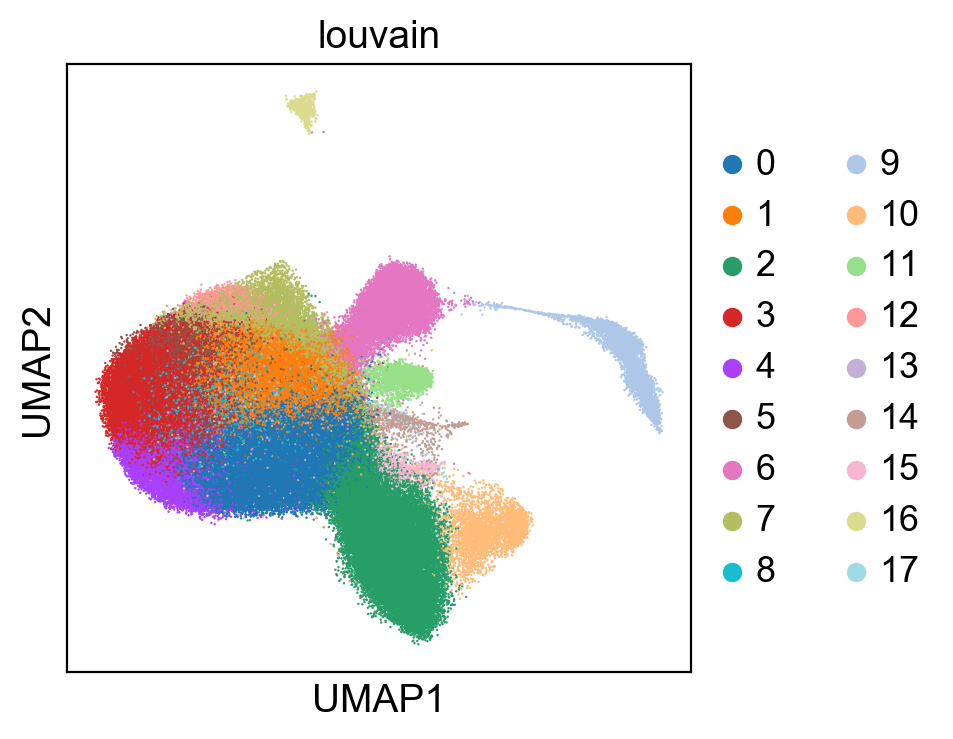

In [6]:
sc.pl.umap(adata, color='louvain', size=3, edgecolor="none")

In [7]:
adata.obs['ct_cov'] = adata.obs['ct_cov'].astype('object')

## do some manual cell type assignment
adata.obs.loc[adata.obs.louvain == "0","ct_cov"] = "cMact" # CCR7, SOCS3-, TNF- CREM-
adata.obs.loc[adata.obs.louvain == "1","ct_cov"] = "cMinf"# CCR7-, GATA3, RORA, CD45+, IL7R, CREM+
adata.obs.loc[adata.obs.louvain == "2","ct_cov"] = "ncM" # PRF1, CD8+, IL7R-
adata.obs.loc[adata.obs.louvain == "3","ct_cov"] = "cM" ## is memory above # CD69+, CCR7+, SOCS3+ CREM+
adata.obs.loc[adata.obs.louvain == "4","ct_cov"] = "cMact" # CCR7+, CD8+
adata.obs.loc[adata.obs.louvain == "5","ct_cov"] = "cM"# CREM+ CD8+, IL7R+
adata.obs.loc[adata.obs.louvain == "6","ct_cov"] = "cDC1" # CCR7+, FOXP1+
adata.obs.loc[adata.obs.louvain == "7","ct_cov"] = "cMinf"# PRF1+, CD8-, IL7+, CREM-, 
adata.obs.loc[adata.obs.louvain == "8","ct_cov"] = "cM" # CCR7+ CD8-, S100A4- 
adata.obs.loc[adata.obs.louvain == "9","ct_cov"] = "pDC" # IL2RA+, CTLA4+, FOXP3+
adata.obs.loc[adata.obs.louvain == "10","ct_cov"] = "ncMcomp" # IFN+, STAT1+
adata.obs.loc[adata.obs.louvain == "11","ct_cov"] = "Mac1" # clec4e
adata.obs.loc[adata.obs.louvain == "12","ct_cov"] = "cM" # STMN1+ SOX4+
adata.obs.loc[adata.obs.louvain == "13","ct_cov"] = "cMinf" # PTCRA+
adata.obs.loc[adata.obs.louvain == "14","ct_cov"] = "Mac2" # MNDA, CD14, FCER1G
adata.obs.loc[adata.obs.louvain == "15","ct_cov"] = "Mac2" # STMN1+ SOX4+
adata.obs.loc[adata.obs.louvain == "16","ct_cov"] = "cDC2" # PTCRA+
adata.obs.loc[adata.obs.louvain == "17","ct_cov"] = "Mac2" # MNDA, CD14, FCER1G

adata.obs['ct_cov'] = adata.obs['ct_cov'].astype('category')

adata.obs.ct_cov = adata.obs.ct_cov.cat.reorder_categories(['cM', 'cMact', 'cMinf', 'Mac1', 'Mac2', 'ncM', 'ncMcomp', 'cDC1', 'cDC2', 'pDC'])

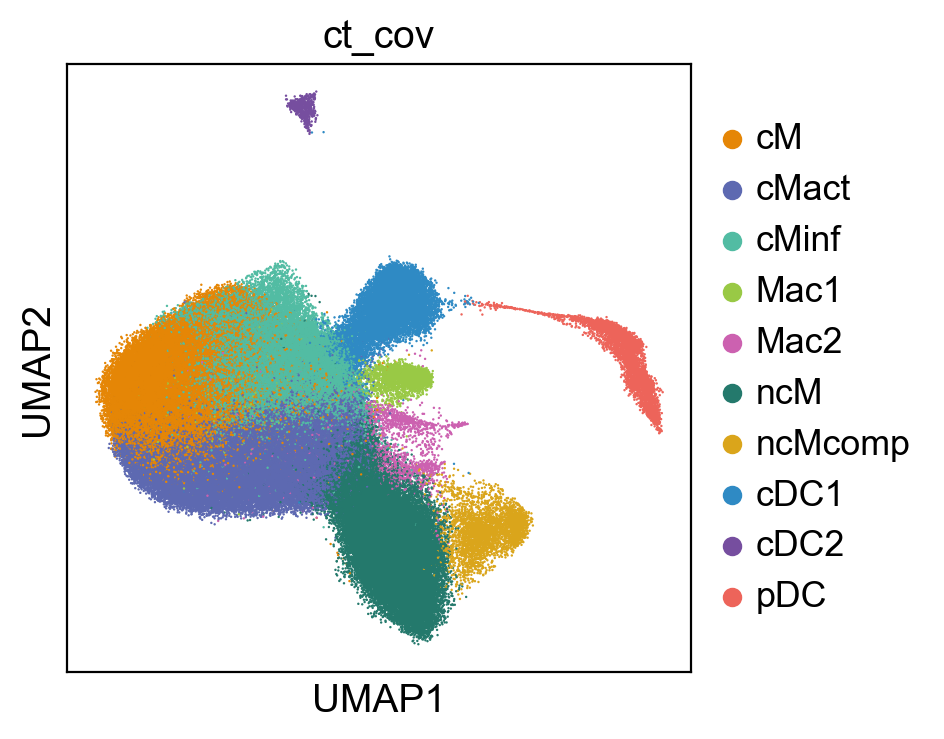

In [8]:
adata.uns['ct_cov_colors'] = ["#E58606","#5D69B1","#52BCA3","#99C945","#CC61B0","#24796C","#DAA51B","#2F8AC4","#764E9F","#ED645A","#CC3A8E","#A5AA99"]

sc.pl.umap(adata, color='ct_cov', size=3, edgecolor="none")
sc.pl.umap(adata, color='ct_cov', size=3, save="_ct_cov_all.png")

In [68]:
adata.obs.to_csv('adata_obs_myeloid.'+version+'.txt')

## Make a pseudobulk expression matrix that's useful for comparisons

In [9]:
def marker_gene_expression(anndata, marker_dict, gene_symbol_key=None, partition_key='louvain_r1'):
    """A function go get mean z-score expressions of marker genes
    # 
    # Inputs:
    #    anndata         - An AnnData object containing the data set and a partition
    #    marker_dict     - A dictionary with cell-type markers. The markers should be stores as anndata.var_names or 
    #                      an anndata.var field with the key given by the gene_symbol_key input
    #    gene_symbol_key - The key for the anndata.var field with gene IDs or names that correspond to the marker 
    #                      genes
    #    partition_key   - The key for the anndata.obs field where the cluster IDs are stored. The default is
    #                      'louvain_r1' """

    #Test inputs
    if partition_key not in anndata.obs.columns.values:
        print('KeyError: The partition key was not found in the passed AnnData object.')
        print('   Have you done the clustering? If so, please tell pass the cluster IDs with the AnnData object!')
        raise

    if (gene_symbol_key != None) and (gene_symbol_key not in anndata.var.columns.values):
        print('KeyError: The provided gene symbol key was not found in the passed AnnData object.')
        print('   Check that your cell type markers are given in a format that your anndata object knows!')
        raise
        

    if gene_symbol_key:
        gene_ids = anndata.var[gene_symbol_key]
    else:
        gene_ids = anndata.var_names

    clusters = anndata.obs[partition_key].cat.categories
    n_clust = len(clusters)
    marker_exp = pd.DataFrame(columns=clusters)
    marker_exp['cell_type'] = pd.Series({}, dtype='str')
    marker_names = []
    
    z_scores = sc.pp.scale(anndata, copy=True)

    i = 0
    for group in marker_dict:
        # Find the corresponding columns and get their mean expression in the cluster
        for gene in marker_dict[group]:
            ens_idx = np.in1d(gene_ids, gene) #Note there may be multiple mappings
            if np.sum(ens_idx) == 0:
                continue
            else:
                z_scores.obs[ens_idx[0]] = z_scores.X[:,ens_idx].mean(1) #works for both single and multiple mapping
                ens_idx = ens_idx[0]

            clust_marker_exp = z_scores.obs.groupby(partition_key)[ens_idx].apply(np.mean).tolist()
            clust_marker_exp.append(group)
            marker_exp.loc[i] = clust_marker_exp
            marker_names.append(gene)
            i+=1

    #Replace the rownames with informative gene symbols
    marker_exp.index = marker_names

    return(marker_exp)

In [10]:
marker_dictionary = pd.DataFrame({"all": adata.var_names})

rst = marker_gene_expression(adata, marker_dictionary, partition_key="ct_cov")

rst.to_csv("myeloid_expr_ct_cov.csv")

# Figure 3B: Ranked genes and stacked violin plot of the markers

ranking genes


/Users/yimmieg/opt/anaconda3/lib/python3.7/site-packages/scanpy/tools/_rank_genes_groups.py:223: RuntimeWarning: invalid value encountered in log2
  rankings_gene_logfoldchanges.append(np.log2(foldchanges[global_indices]))


    finished (0:00:19)


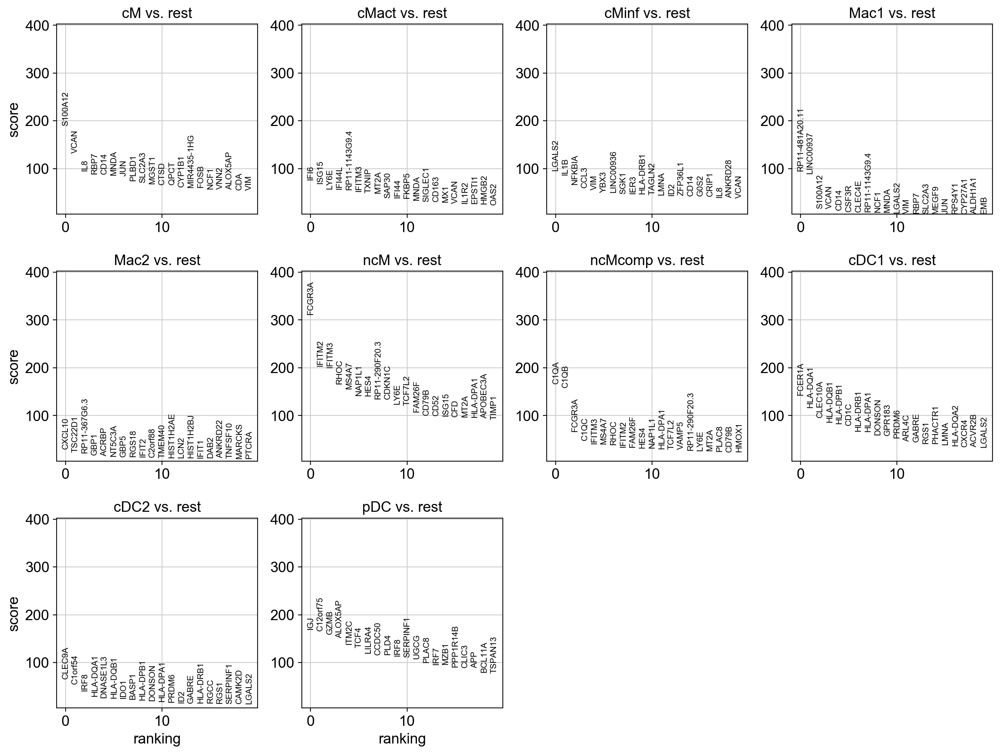

In [11]:
sc.tl.rank_genes_groups(adata, n_genes=20, groupby='ct_cov', use_raw=False)
sc.pl.rank_genes_groups(adata)

In [12]:
pd.set_option('display.max_columns', None)
unique_ct_cov = np.unique(adata.obs['ct_cov'].values)
# Compile list of top genes
GeneRanks = pd.DataFrame()
for ii in range(len(unique_ct_cov)):
    GeneRanks[unique_ct_cov[ii]] = adata.var_names[np.flipud(np.argsort(np.mean(adata.X[adata.obs['ct_cov'] == unique_ct_cov[ii]], axis=0)))]
##GeneRanks.to_csv('FLARE_top_expression.csv')
GeneRanks.head(20)

,Mac1,Mac2,cDC1,cDC2,cM,cMact,cMinf,ncM,ncMcomp,pDC
0,RP11-481A20.11,CXCL10,FCER1A,CLEC9A,S100A12,IFI6,LGALS2,FCGR3A,C1QB,LILRA4
1,LINC00937,RP11-367G6.3,CLEC10A,IDO1,VCAN,ISG15,IL1B,RHOC,C1QA,IGJ
2,S100A12,TSC22D1,CD1C,C1orf54,IL8,IFI44L,CCL3,CDKN1C,C1QC,ITM2C
3,VCAN,C2orf88,HLA-DQA1,DNASE1L3,RBP7,LY6E,NFKBIA,HES4,FCGR3A,SERPINF1
4,CD14,LCN2,HLA-DQB1,IRF8,CD14,RP11-1143G9.4,VIM,IFITM2,RHOC,GZMB
5,CSF3R,TMEM40,HLA-DPB1,BASP1,MNDA,IFITM3,LMNA,IFITM3,HES4,MZB1
6,CLEC4E,ACRBP,GPR183,S100B,JUN,MT2A,YBX3,MS4A7,MS4A7,TPM2
7,RP11-1143G9.4,HIST1H2BJ,LMNA,HLA-DQA1,PLBD1,SAP30,SGK1,TCF7L2,LYPD2,SCT
8,MNDA,HIST1H2AE,HLA-DPA1,SERPINF1,QPCT,TXNIP,LINC00936,RP11-290F20.3,TCF7L2,LRRC26
9,NCF1,RAB27B,HLA-DRB1,HLA-DQB1,SLC2A3,IFI44,IER3,NAP1L1,IFITM3,DERL3


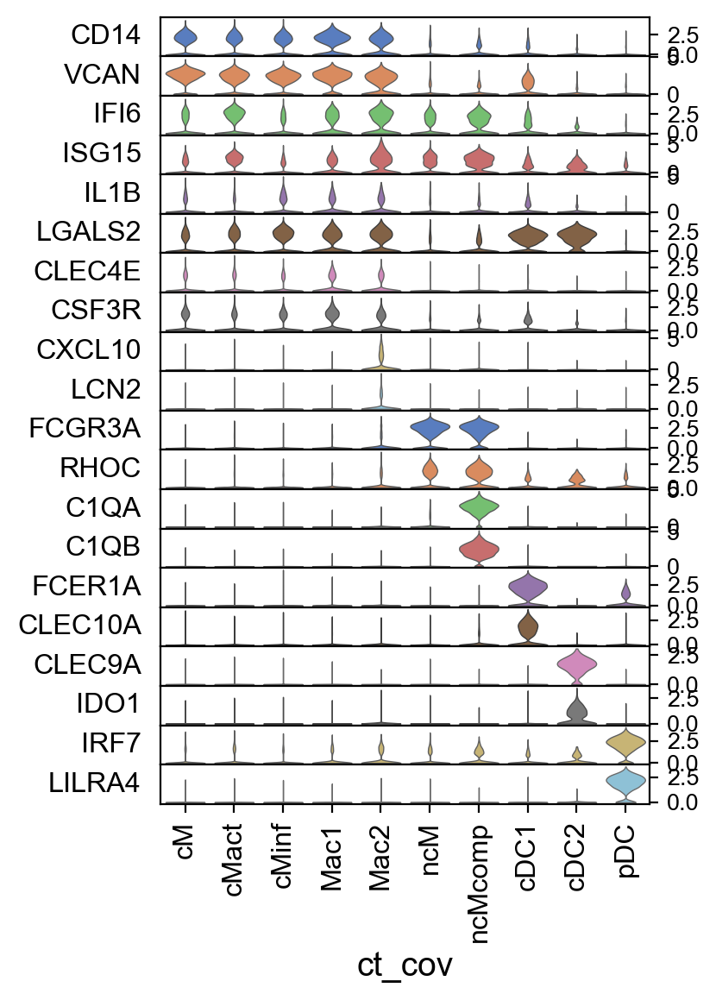

In [13]:
sc.pl.stacked_violin(adata, var_names=['CD14','VCAN','IFI6','ISG15','IL1B','LGALS2','CLEC4E','CSF3R','CXCL10','LCN2','FCGR3A','RHOC','C1QA','C1QB','FCER1A','CLEC10A', 'CLEC9A','IDO1','IRF7','LILRA4'], groupby="ct_cov", swap_axes= True)
sc.pl.stacked_violin(adata, var_names=['CD14','VCAN','IFI6','ISG15','IL1B','LGALS2','CLEC4E','CSF3R','CXCL10','LCN2','FCGR3A','RHOC','C1QA','C1QB','FCER1A','CLEC10A','CLEC9A','IDO1','IRF7','LILRA4'], groupby="ct_cov", save="_violin.png", swap_axes=True)

## Make some feature plots for supplementary materials

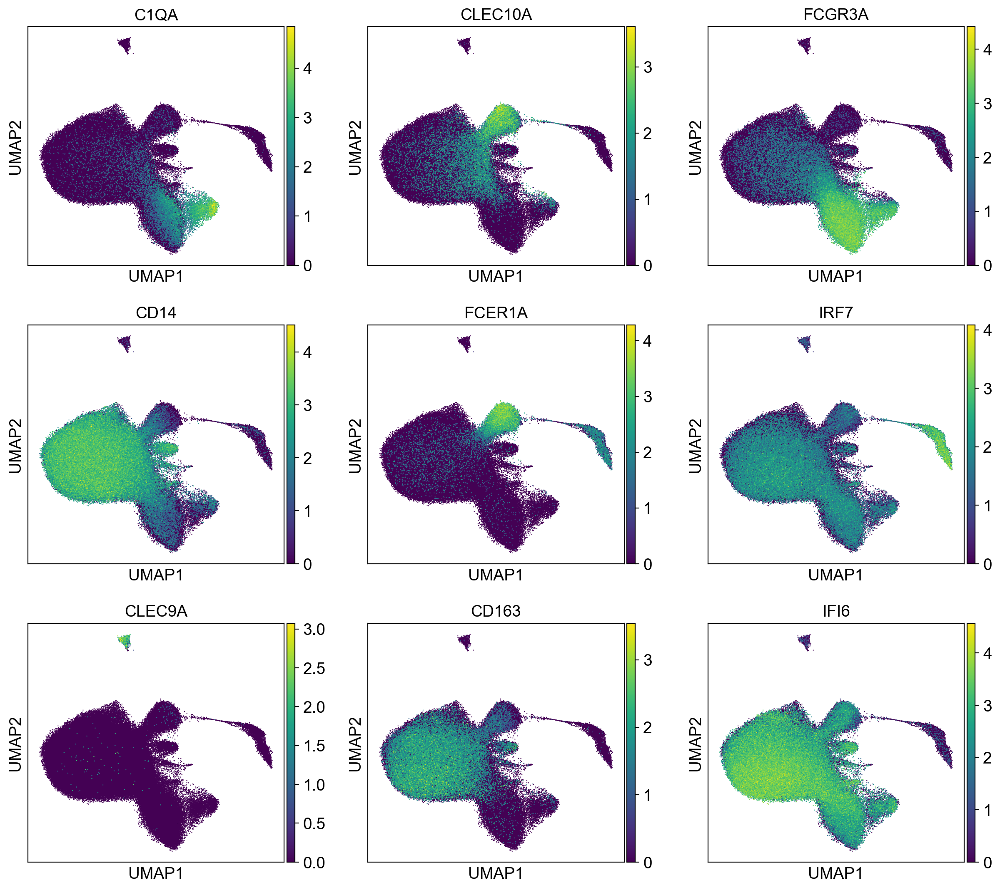

In [14]:
sc.pl.umap(adata, color=['C1QA','CLEC10A','FCGR3A', 'CD14', 'FCER1A', 'IRF7', 'CLEC9A', 'CD163', 'IFI6'], size=3, ncols=3)
sc.pl.umap(adata, color=['C1QA','CLEC10A','FCGR3A', 'CD14', 'FCER1A', 'IRF7', 'CLEC9A', 'CD163', 'IFI6'], size=3, ncols=3, save="_ct_markers.png")

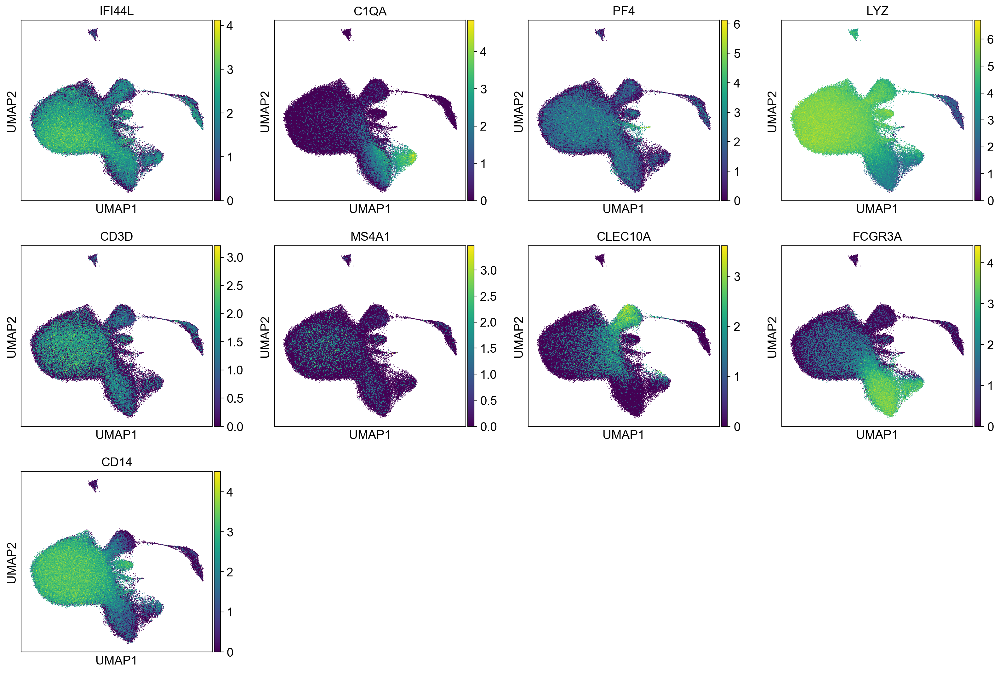

In [15]:
sc.pl.umap(adata, color=['IFI44L','C1QA','PF4','LYZ','CD3D','MS4A1', 'CLEC10A', 'FCGR3A', 'CD14'], size=3)

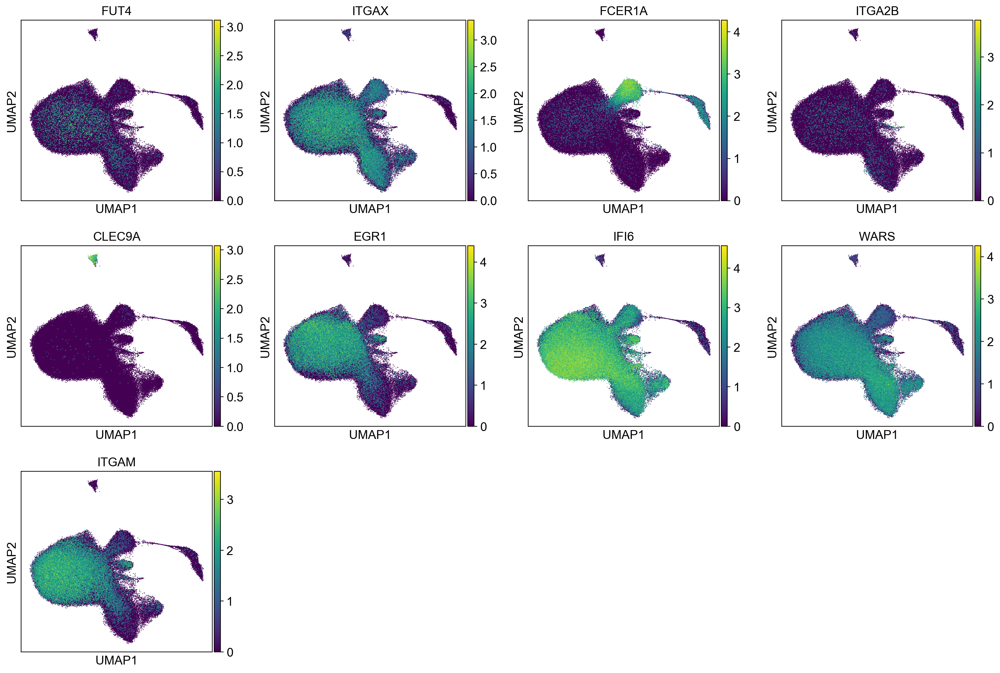

In [16]:
sc.pl.umap(adata, color=['FUT4', 'ITGAX', 'FCER1A', 'ITGA2B', 'CLEC9A', 'EGR1', 'IFI6', 'WARS', 'ITGAM'], size=3)

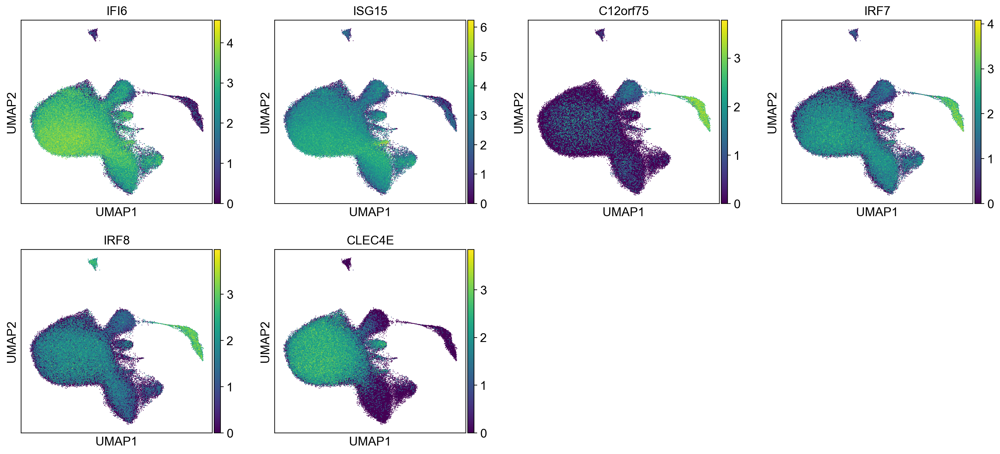

In [17]:
sc.pl.umap(adata, color=['IFI6', 'ISG15', 'C12orf75', 'IRF7', 'IRF8', 'CLEC4E'], size=3)

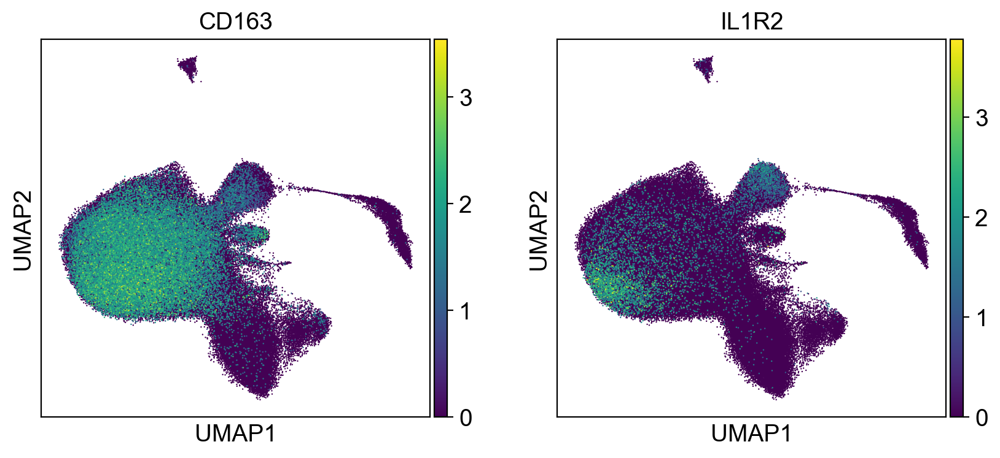

In [18]:
sc.pl.umap(adata, color=['CD163', 'IL1R2'], size=3)

# Figure 3C: Embedding and qualitative enrichment

In [19]:
sc.tl.embedding_density(adata, basis='umap', groupby='disease_pop_site_cov')


computing density on 'umap'


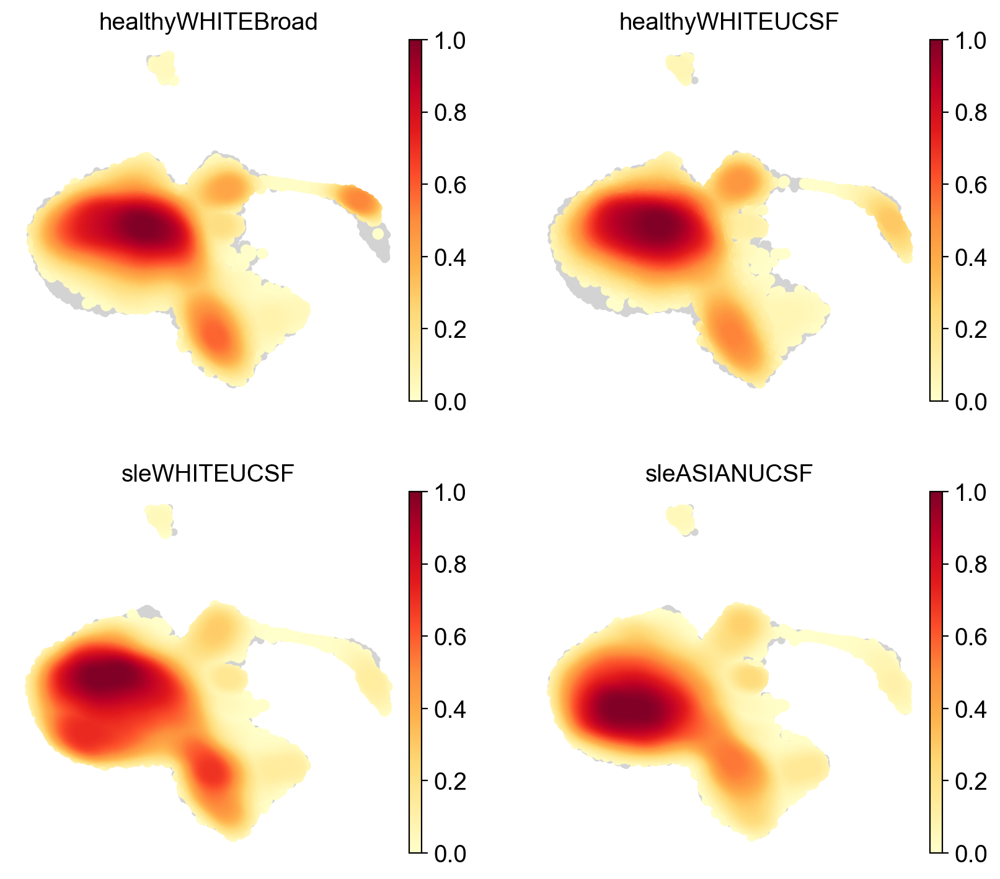

In [20]:
disease_umap = sc.pl.embedding_density(adata, basis="umap", key="umap_density_disease_pop_site_cov", frameon=False, ncols=2)
disease_umap = sc.pl.embedding_density(adata, basis="umap", key="umap_density_disease_pop_site_cov", frameon=False, ncols=2, save=".png")

# Figure 3D: Differences in subtype percentages for ALL samples

## Weighted least squares normalizing by total number of PBMCs

In [21]:
joined_pivot = pd.read_csv("CLUESImmVar_processed_joined_pivot_ct_perc."+version+".txt",index_col=False)

In [22]:
adata_obs_small = adata.obs;

ind_count = adata_obs_small.groupby(['ind_cov','ct_cov','disease_cov','pop_cov','batch_cov','site','disease_pop_site_cov'])['ct_cov'].count()

##ind_count = adata.obs.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()
##ind_count = adata.obs.groupby(['ind_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()

##ind_count = ind_count.reset_index(name="counts")
ind_count_sums = ind_count.groupby(["ind_cov","batch_cov"]).sum()
ind_count_sums = ind_count_sums.reset_index(name="counts")

##ind_perc = ind_count/ind_count.groupby(["ind_cov","batch_cov"]).transform(sum)*100
##ind_perc = ind_count/ind_count.groupby(["ind_cov","batch_cov"]).transform(sum)*100
ind_count = ind_count.reset_index(name="ct_count")

## filter samples that have < 100 cells
ind_count = ind_count[ind_count.ind_cov.isin(ind_count_sums.ind_cov[ind_count_sums.counts > 100])]


ind_count.ind_cov = ind_count.ind_cov.apply(lambda x: x.split('_')[0])
ind_count_sums.ind_cov = ind_count_sums.ind_cov.apply(lambda x: x.split('_')[0])
ind_count.ind_cov = ind_count.ind_cov.astype("str")
ind_count.batch_cov = ind_count.batch_cov.astype("str")
ind_count.reset_index(inplace=True)
ind_count.ct_cov = ind_count.ct_cov.astype('category')
ind_count.ct_cov = ind_count.ct_cov.cat.reorder_categories(adata.obs.ct_cov.cat.categories.values)

ind_count = ind_count.join(joined_pivot.set_index(["ind_cov", 'disease_cov', 'batch_cov','disease_pop_site_cov']), on=["ind_cov", 'disease_cov', 'batch_cov','disease_pop_site_cov'])
ind_count = ind_count[~np.isnan(ind_count.pbmc_counts)]

ind_perc = ind_count;
ind_perc["ct_perc"] = ind_count.ct_count/ind_count.pbmc_counts*100


In [23]:
print("ind_count.shape: ",ind_count.shape)
print("ind_count_sums.shape: ", ind_count_sums.shape)
print("len(ind_count.ind_cov): ", len(ind_count.ind_cov))
print("len(ind_count.ind_cov.unique): ", len(ind_count.ind_cov.unique()))

## for now, let's filter out one of the reps for the healthies from UCSF only
## and filter out any broad samples that were replicated at UCSF
ind_perc_broad = ind_perc[~ind_perc.batch_cov.str.contains("lupus")]
ind_perc_ucsf = ind_perc[ind_perc.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ct_cov','ind_cov'])
ind_perc_all = ind_perc_ucsf.append(ind_perc_broad);

ind_count_broad = ind_count[~ind_count.batch_cov.str.contains("lupus")]
ind_count_ucsf = ind_count[ind_count.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ind_cov'])
ind_count_all = ind_count_ucsf.append(ind_count_broad);

ind_count_sums_broad = ind_count_sums[~ind_count_sums.batch_cov.str.contains("lupus")]
ind_count_sums_ucsf = ind_count_sums[ind_count_sums.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ind_cov'])
ind_count_sums_all = ind_count_sums_ucsf.append(ind_count_sums_broad);

ind_count.shape:  (1846, 77)
ind_count_sums.shape:  (2366, 3)
len(ind_count.ind_cov):  1846
len(ind_count.ind_cov.unique):  169


## Plot the figures

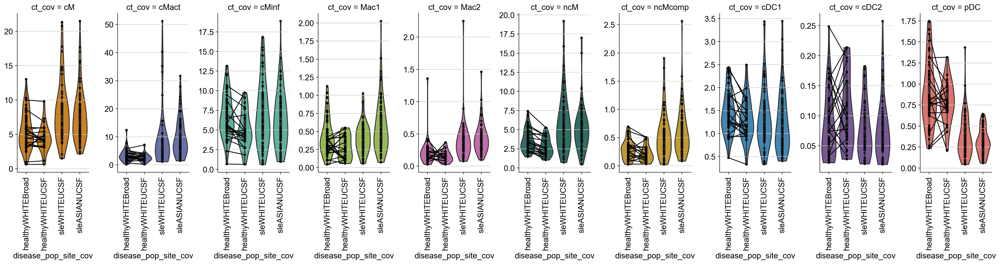

In [24]:
##plt.figure(figsize=(20,8))

ind_perc_all['site'] = pd.Categorical(ind_perc_all.disease_cov, categories=['Broad','UCSF'])
ind_perc_all.site[ind_perc_all.batch_cov.str.contains("immvar")] = "Broad"
ind_perc_all.site[~ind_perc_all.batch_cov.str.contains("immvar")] = "UCSF"

ind_perc_all['disease_pop_cov'] = pd.Categorical(ind_perc_all.apply(lambda row: row['disease_cov'] + row['pop_cov'], axis=1),
                                             categories=['healthyWHITE','sleWHITE','sleASIAN'],
                                             ordered=True)

ind_perc_all['disease_pop_site_cov'] = pd.Categorical(ind_perc_all.apply(lambda row: row['disease_cov'] + row['pop_cov'] + row['site'], axis=1),
                                             categories=['healthyWHITEBroad','healthyWHITEUCSF','sleWHITEUCSF','sleASIANUCSF'],
                                             ordered=True)


plot=sb.catplot(x='disease_pop_site_cov', y='ct_perc', hue='ct_cov', data=ind_perc_all, kind='violin', col='ct_cov', 
                dodge=False, aspect=0.5, height=5, sharex=False, sharey=False, cut=0, col_wrap=10,
               palette = ["#E58606","#5D69B1","#52BCA3","#99C945","#CC61B0","#24796C","#DAA51B","#2F8AC4","#764E9F","#ED645A","#CC3A8E","#A5AA99"]) #, palette=sc.pl.palettes.vega_20_scanpy
plot.set_xticklabels(rotation=90)
plot.fig.subplots_adjust(wspace=0.4, hspace=0.75)

for ct_i in list(range(len(ind_perc_all.ct_cov.cat.categories))) :
    ct = ind_perc_all.ct_cov.cat.categories[ct_i]
    
    sb.pointplot(x="disease_pop_site_cov", y="ct_perc", hue = "ind_cov", data=ind_perc_all[ind_perc_all.ct_cov == ct], color="0", scale=0.5,
                 ax=plot.axes[ct_i], legend=False)
    
    plot.axes[ct_i].get_yaxis().label.set_visible(False)
    plot.axes[ct_i].get_legend().remove()
    
    plot.axes[ct_i].get_yaxis().label.set_visible(False)

plot.savefig(figdir+"/violin_myeloid.png")


## Compute statistics

In [25]:
ind_count = ind_count_all.drop_duplicates(subset=['ct_cov','ind_cov']);
ind_count_sums = ind_count_sums_all.drop_duplicates(subset=['ind_cov']);
ind_perc = ind_perc.drop_duplicates(subset=['ct_cov','ind_cov']);

all_out = pd.DataFrame()

print('\nall sle vs all healthy')

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc.ct_perc[ind_perc.ct_cov==ct]
    disease = ind_perc.disease_cov[ind_perc.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    
    weights = ind_perc[ind_perc.ct_cov==ct].pbmc_counts;
    est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)
    
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    ##r2=est.rsquared
    logfc = math.log2(sum(est.params)/est.params[0])
    #print(effect)
    #print(pval)
    all_out = all_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval), "LogFC": str(logfc)}), ignore_index=True)
display(all_out);

print('\nwhite sle vs white healthy')

white_out = pd.DataFrame();

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ind_perc_small = ind_perc[ind_perc.pop_cov=="WHITE"];
    
    ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
    disease = ind_perc_small.disease_cov[ind_perc_small.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    
    weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
    est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)

    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    logfc = math.log2(sum(est.params)/est.params[0])
    #print(effect)
    #print(pval)
    white_out = white_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval), "LogFC": str(logfc)}), ignore_index=True)
display(white_out); ##print(white_out)

asian_sle_white_out = pd.DataFrame();
    
print('\nasian sle vs white healthy')

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ind_perc_small = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))]
   
    ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
    disease = ind_perc_small.disease_cov[ind_perc_small.ct_cov==ct]
    
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    
    weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
    est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)
    
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    logfc = math.log2(sum(est.params)/est.params[0])
    #print(effect)
    #print(pval)
    asian_sle_white_out = asian_sle_white_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval), "LogFC": str(logfc)}), ignore_index=True)
display(asian_sle_white_out); ##print(white_out) 
  
print('\nwhite sle vs asian sle')

asian_white_sle_out = pd.DataFrame();

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ind_perc_small = ind_perc[ind_perc.disease_cov=="sle"];
    
    ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
    pop = ind_perc_small.pop_cov[ind_perc_small.ct_cov==ct]
    
    pop = pop.astype("str")
    pop.values[pop=="ASIAN"] = 0
    pop.values[pop=="WHITE"] = 1
    pop = sm.add_constant(pop)
   
    ##data = data.assign(ct_perc=ct_perc)
    weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
    est=sm.WLS(ct_perc.astype(float), pop.astype(float), weights=weights)
    
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    logfc = math.log2(sum(est.params)/est.params[0])
    #print(effect)
    #print(pval)
    asian_white_sle_out = asian_white_sle_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval), "LogFC": str(logfc)}), ignore_index=True)
display(asian_white_sle_out); ##print(white_out)  


all sle vs all healthy


/Users/yimmieg/opt/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2495: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


,Beta,Cell,LogFC,Pval
0,-2.4913904100464626,cM,-0.5303654692368822,0.0003374860642821542
1,-5.663884436318822,cMact,-1.3961545337623849,2.4708992802920195e-05
2,0.11685107395275862,cMinf,0.02489527228843615,0.8532156862990768
3,-0.06188613300503243,Mac1,-0.19256609492673485,0.24750486816778322
4,-0.1965305313285689,Mac2,-0.9490776259674889,1.9933024554233132e-05
5,-1.7748336656472028,ncM,-0.576567367096294,0.0006353881236708505
6,-0.2698044964799544,ncMcomp,-0.9578572911380019,3.718183769132784e-05
7,0.22057359297650644,cDC1,0.23166035007456567,0.04132906490172937
8,0.001354578176098616,cDC2,0.02548047327596495,0.8877768063393439
9,0.5631744025494727,pDC,1.4099424704802486,9.869299722483444e-25



white sle vs white healthy


,Beta,Cell,LogFC,Pval
0,-2.890754748660205,cM,-0.5998076815043604,0.00021031254342595274
1,-5.305220926913194,cMact,-1.3383649089489658,0.0009615622287725762
2,-0.1434140020493243,cMinf,-0.029978778598095886,0.8355029251709747
3,0.027146596327330047,Mac1,0.09332086786048371,0.5460999784939466
4,-0.16760958316091132,Mac2,-0.8429285995485996,0.0015382289059205107
5,-2.1597452195602074,ncM,-0.676127658262119,0.0002598096252024601
6,-0.2349239659602045,ncMcomp,-0.8644026531405675,0.00026306121703256063
7,0.1669744694186686,cDC1,0.1718525742374051,0.1462783246408405
8,0.002512208014474212,cDC2,0.04761864913281788,0.8096330995688246
9,0.5311343696050476,pDC,1.2799540640087061,8.494213588971694e-14



asian sle vs white healthy


,Beta,Cell,LogFC,Pval
0,-2.1544196379449536,cM,-0.4690548063951244,0.001683385757711874
1,-5.96651315902494,cMact,-1.443177153667542,6.666916390729432e-08
2,0.33645436631458053,cMinf,0.07287717879807323,0.602039355878415
3,-0.13569394431647291,Mac1,-0.39297343618288355,0.035550908884619904
4,-0.2209330963342264,Mac2,-1.0329417001396923,1.8459078034981585e-06
5,-1.450057687994616,ncM,-0.48686323248066127,0.002322254717879067
6,-0.2992355652162101,ncMcomp,-1.0322596355064095,1.750424539417437e-05
7,0.2657988079066689,cDC1,0.28412742065875507,0.02103682217515358
8,0.0003755834852184818,cDC2,0.007019990758747643,0.972954844336424
9,0.5906314806819732,pDC,1.5314894851694931,3.05428652007419e-20



white sle vs asian sle


,Beta,Cell,LogFC,Pval
0,0.7363351107152522,cM,0.13075287510923625,0.34621884997301733
1,-0.6612922321117458,cMact,-0.10481224471857585,0.6752964398087338
2,0.4798683683639048,cMinf,0.10285595739616932,0.5022461295567014
3,-0.16284054064380296,Mac1,-0.4862943040433664,0.005512915635373648
4,-0.05332351317331517,Mac2,-0.19001310059109264,0.28588199634256556
5,0.7096875315655913,ncM,0.18926442578145772,0.2384898257718135
6,-0.06431159925600552,ncMcomp,-0.16785698236584126,0.3943568690896785
7,0.09882433848800032,cDC1,0.11227484642134981,0.41232941980036997
8,-0.002136624529255742,cDC2,-0.04059865837407011,0.8266788226364243
9,0.05949711107692533,pDC,0.2515354211607872,0.11920655579530628


# Figure 3E: Correlation of composition with IFN score

## Read in interferon score calculation and join

In [35]:
ifn = pd.read_table("../meta/ifn_sig.V2.txt", sep=" ", index_col=False)
ifn.name = ifn.name.apply(lambda x: x.split('_')[0])
joined2 = ifn.join(ind_perc.set_index("ind_cov"), on="name")

joined2["disease_pop_site_cov"] = joined2["disease_pop_site_cov"].astype(str)
joined2["ct_cov"] = joined2["ct_cov"].astype(str)

## Calculate statistics using linear regression

In [36]:
joined_pivot2_percs = joined2.pivot_table(index=['name',"disease_pop_site_cov","pbmc","ifn"], columns="ct_cov", values="ct_perc")
joined_pivot2_percs.reset_index(inplace=True)

##print(joined_pivot2_percs[joined_pivot2_percs.pbmc < 0])
joined_pivot2_percs = joined_pivot2_percs[joined_pivot2_percs.pbmc > 0]

##print(joined_pivot2_percs[joined_pivot2_percs.pbmc > 10])
joined_pivot2_percs = joined_pivot2_percs[joined_pivot2_percs.pbmc < 10]

all_ifn_out = pd.DataFrame();

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = joined_pivot2_percs[ct]
    ifn = joined_pivot2_percs.ifn
    ifn = sm.add_constant(ifn)
    est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    r2=est.rsquared
    cor=joined_pivot2_percs.ifn.corr(joined_pivot2_percs[ct])
    
    all_ifn_out = all_ifn_out.append({'Cluster': str(ct), 'Beta': str(effect), 'R2': str(r2), 'pvalue': str(pval), 'cor': str(cor)}, ignore_index=True)
display(all_ifn_out)
    
    
sle_ifn_out = pd.DataFrame();

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ##ct_perc = joined_pivot2_percs[ct]
    ifn = joined_pivot2_percs.ifn
    ifn = sm.add_constant(ifn)
    
    sle_only = joined_pivot2_percs[joined_pivot2_percs.disease_pop_site_cov.str.contains("sle")]
    
    ##print('Cluster type:'+ ct)
    est=sm.OLS(sle_only[ct].astype(float), sm.add_constant(sle_only.ifn).astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    r2=est.rsquared
    cor=sle_only.ifn.corr(sle_only[ct])
    sle_ifn_out = sle_ifn_out.append({'Cluster': str(ct), 'Beta': str(effect), 'R2': str(r2), 'pvalue': str(pval), 'cor': str(cor)}, ignore_index=True)
display(sle_ifn_out)



as a proportion of cell type


,Beta,Cluster,R2,cor,pvalue
0,0.09642042675052284,cM,0.015588533892134993,0.12485405036335595,0.1619326947352676
1,0.9906820891684235,cMact,0.362614010092151,0.6021744017244103,6.95395953975146e-14
2,-0.28929352369898265,cMinf,0.17079848233167094,-0.41327773026340403,1.3720111034704267e-06
3,0.007982371923155792,Mac1,0.018612041954789382,0.13642595777486566,0.12769697416226888
4,0.026755370800229925,Mac2,0.2733559360173724,0.52283452068257,2.872076681498366e-10
5,0.20494937972158916,ncM,0.11629840518151979,0.3410255198390878,8.729161800823732e-05
6,0.034360686997127445,ncMcomp,0.2036695116995687,0.4512975866316685,1.0092607530376943e-07
7,-0.039010608875910305,cDC1,0.10346540305476237,-0.3216603846524504,0.00022639082758711912
8,-0.00047012921128683363,cDC2,0.002722157616160348,-0.05217430034183758,0.5900228383726218
9,-0.01349548527580844,pDC,0.07144579249308824,-0.2672934576324094,0.0024804901186968754


as a proportion of cell type


,Beta,Cluster,R2,cor,pvalue
0,0.008570710839647635,cM,0.00011562015597210706,0.010752681338721384,0.9091955649143411
1,0.9977404267831613,cMact,0.3267676200021926,0.5716359155985503,2.5187063680045735e-11
2,-0.37553604655066797,cMinf,0.2532658842297968,-0.5032552873341682,9.908816134069624e-09
3,0.003144768571051712,Mac1,0.0025756864682574543,0.05075122134744753,0.5917866593215809
4,0.024127547476668478,Mac2,0.2081127305625292,0.4561937423535411,2.995120582385878e-07
5,0.19591342446382184,ncM,0.09422507782122325,0.30696103632419414,0.000847588449784533
6,0.03343512265742089,ncMcomp,0.17130793163093716,0.4138936235688312,4.266611356068207e-06
7,-0.039279650761965025,cDC1,0.09686219104966565,-0.3112269124765174,0.0007103153009535126
8,-0.0004162710546379006,cDC2,0.0019741356879815486,-0.04443124675250164,0.6656413415110669
9,-0.0026126462519039852,pDC,0.004063331827799499,-0.06374426898003922,0.5004463619343138


## Plot the figures

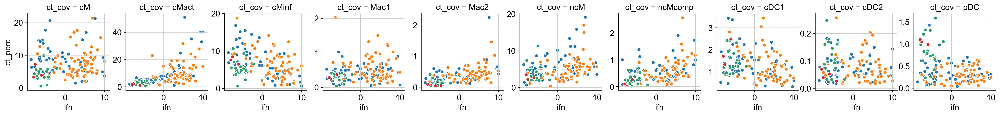

In [37]:
joined2_plot = joined2
joined2_plot.ct_cov = joined2_plot.ct_cov.astype('category')
joined2_plot.ct_cov = joined2_plot.ct_cov.cat.reorder_categories(['cM', 'cMact', 'cMinf', 'Mac1', 'Mac2', 'ncM', 'ncMcomp', 'cDC1', 'cDC2', 'pDC'])

g = sb.FacetGrid(joined2_plot, col="ct_cov",  hue="disease_pop_site_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy, col_wrap=10)
g = g.map(plt.scatter, "ifn", "ct_perc", edgecolor="w")
g.fig.subplots_adjust(wspace=0.2)
g.savefig(figdir+"/ifn_ct_cov.png")

# Figure 3F: Features plot of IFN module scores from Fig 2

## Let's recompute IFN score based on Figure 2 modules

In [39]:
diffexp_annot = pd.read_csv("diffexp_annotations.txt", sep="\t", index_col=False)
diffexp_annot.cluster = diffexp_annot.cluster.astype("category")

In [40]:
for cluster_i in diffexp_annot.cluster.cat.categories:
    print(cluster_i)
    cluster_X = adata.X[:,adata.var_names.isin(diffexp_annot.gene[diffexp_annot.cluster==cluster_i])];
    adata.obs[cluster_i] = np.sum(cluster_X, axis=1)
    

B
Lymph
Mono
Pan
T4
T8
ncM
pDC


## Make the feature plots

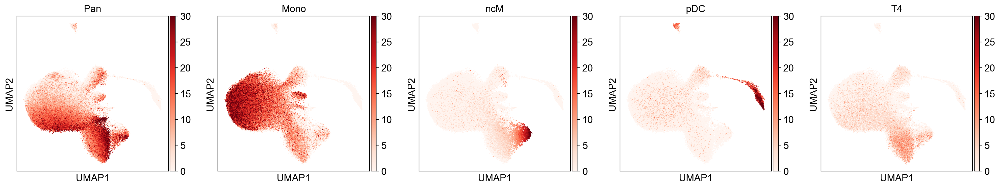

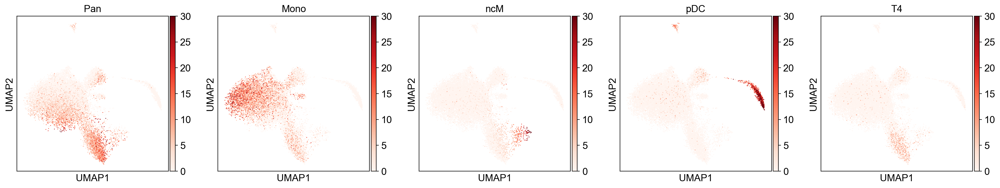

In [41]:
sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['Pan',"Mono", "ncM", "pDC", "T4"], size=5, vmin=0, color_map=plt.cm.Reds, vmax=30, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[(adata.obs.disease_cov=="healthy") & (adata.obs.Broad == 0)], color=['Pan',"Mono", "ncM", "pDC", "T4"], color_map=plt.cm.Reds, size=5, vmin=0, vmax=30, ncols=5) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['Pan',"Mono", "ncM", "pDC", "T4"], size=5, save='_ifn_sle.png', color_map=plt.cm.Reds,vmin=0, vmax=30, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[(adata.obs.disease_cov=="healthy") & (adata.obs.Broad == 0)], color=['Pan',"Mono", "ncM", "pDC", "T4"], size=5, color_map=plt.cm.Reds,save='_ifn_healthy.png', vmin=0, vmax=30, ncols=5) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

## Make individual gene feature plots for activation markers

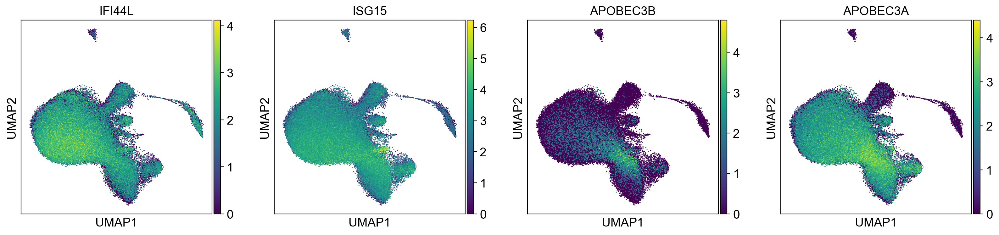

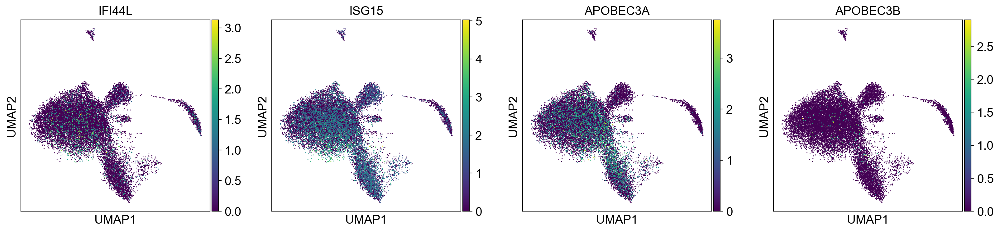

In [42]:
sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['IFI44L',"ISG15","APOBEC3B","APOBEC3A"], size=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[(adata.obs.disease_cov=="healthy") & (adata.obs.Broad == 0)], color=['IFI44L',"ISG15","APOBEC3A","APOBEC3B"], size=5) ##,vmin=min(adata.obs.all_ifn), vmax=maex(adata.obs.all_ifn)*.75)


## Make individual gene feature plots for myeloid types

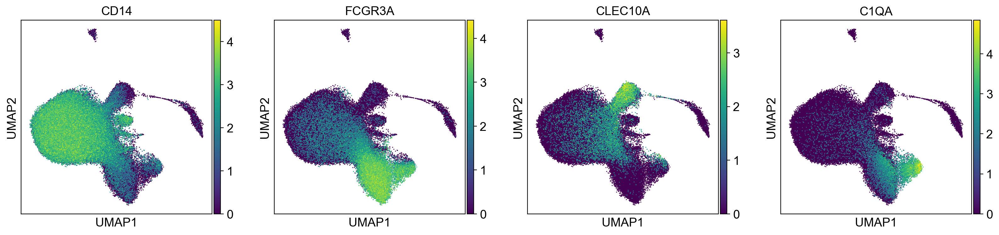

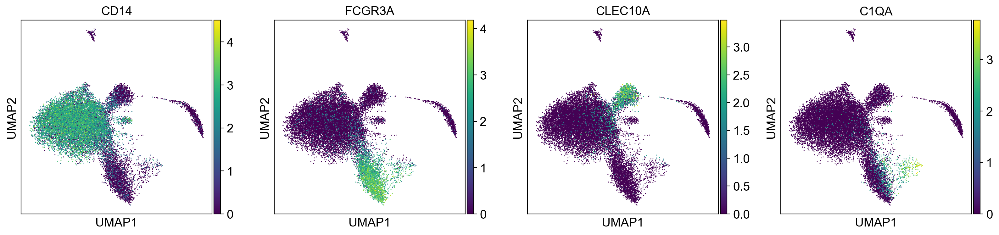

In [43]:
sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['CD14',"FCGR3A","CLEC10A","C1QA"], size=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[(adata.obs.disease_cov=="healthy") & (adata.obs.Broad == 0)], color=['CD14',"FCGR3A","CLEC10A","C1QA"], size=5) ##,vmin=min(adata.obs.all_ifn), vmax=maex(adata.obs.all_ifn)*.75)

# Figure 3G: SLEDAI vs IFN modules

In [44]:
colors = ["#fee8c8","#fdbb84","#ef6548","#990000"]
data = adata.copy();

# Slice matrix to remove people not in Monocyte results
clues_clinical2 = pd.read_table("../meta/Clinical_Data.V2.txt", index_col=False)
clues_clinical2 = clues_clinical2[clues_clinical2['genotypeid'].isin(data.obs['ind_cov'].values.tolist())]
ifn_genes = pd.read_csv('../meta/ifn_lupus_crow_etal.txt', header=None)

genes_lineage = data.var_names[data.var_names.isin(['CD14', 'FCGR3A'])].tolist()
genes_pan_ifn = data.var_names[data.var_names.isin(diffexp_annot.gene[diffexp_annot.cluster.isin(["Pan"])])].tolist()
genes_mono_ifn = data.var_names[data.var_names.isin(diffexp_annot.gene[diffexp_annot.cluster.isin(["Mono"])])].tolist()
genes_ncm_ifn = data.var_names[data.var_names.isin(diffexp_annot.gene[diffexp_annot.cluster.isin(["ncM"])])].tolist()
genes_pdc_ifn = data.var_names[data.var_names.isin(diffexp_annot.gene[diffexp_annot.cluster.isin(["pDC"])])].tolist()
genes_ifn = data.var_names[data.var_names.isin(ifn_genes[0])].tolist()

# Order cells
PC = np.asarray(sc.pp.pca(data[:,genes_lineage].X, n_comps=1, copy=True)).reshape(-1,)
data.obs['PC_axis1'] = list(PC)
PC = np.asarray(sc.pp.pca(data[:,genes_pan_ifn].X, n_comps=1, copy=True)).reshape(-1,)
data.obs['PC_axis2'] = list(PC)
PC = np.asarray(sc.pp.pca(data[:,genes_mono_ifn].X, n_comps=1, copy=True)).reshape(-1,)
data.obs['PC_axis3'] = list(-PC)
PC = np.asarray(sc.pp.pca(data[:,genes_ncm_ifn].X, n_comps=1, copy=True)).reshape(-1,)
data.obs['PC_axis4'] = list(-PC)
PC = np.asarray(sc.pp.pca(data[:,genes_pdc_ifn].X, n_comps=1, copy=True)).reshape(-1,)
data.obs['PC_axis5'] = list(PC)
##PC = np.asarray(sc.pp.pca(data[:,genes_monocytes_ifn].X, n_comps=1, copy=True)).reshape(-1,)
PC = np.asarray(sc.pp.pca(data[:,genes_ifn].X, n_comps=1, copy=True)).reshape(-1,)
data.obs['PC_axis6'] = list(PC)

ind_healthy = data.obs['ind_cov'][data.obs['disease_cov']=='healthy'].tolist()
healthyall_axis1 = np.asarray(data.obs['PC_axis1'][data.obs['ind_cov'].isin(ind_healthy)].values.tolist())
healthyall_axis2 = np.asarray(data.obs['PC_axis2'][data.obs['ind_cov'].isin(ind_healthy)].values.tolist())
healthyall_axis3 = np.asarray(data.obs['PC_axis3'][data.obs['ind_cov'].isin(ind_healthy)].values.tolist())
healthyall_axis4 = np.asarray(data.obs['PC_axis4'][data.obs['ind_cov'].isin(ind_healthy)].values.tolist())
healthyall_axis5 = np.asarray(data.obs['PC_axis5'][data.obs['ind_cov'].isin(ind_healthy)].values.tolist())
healthyall_axis6 = np.asarray(data.obs['PC_axis6'][data.obs['ind_cov'].isin(ind_healthy)].values.tolist())

# Some SLEDAI scores to cut at
SLEDAI = [np.percentile(clues_clinical2['sledaiscore'].tolist(),25), np.percentile(clues_clinical2['sledaiscore'].tolist(),50), np.percentile(clues_clinical2['sledaiscore'].tolist(),75), np.percentile(clues_clinical2['sledaiscore'].tolist(),100)]
print(SLEDAI)
##colors = ['r', 'g', 'k', 'y', 'm']
sleall_axis1 = {};
sleall_axis2 = {};
sleall_axis3 = {};
sleall_axis4 = {};
sleall_axis5 = {};
sleall_axis6 = {};

for ii in range(len(SLEDAI)):
    if ii == SLEDAI[0]:
        disease_sub = clues_clinical2['genotypeid'][clues_clinical2['sledaiscore'] <= SLEDAI[ii]]
    else:
        disease_sub = clues_clinical2['genotypeid'][(clues_clinical2['sledaiscore'] <= SLEDAI[ii]) & (clues_clinical2['sledaiscore'] > SLEDAI[ii-1])]

    ind_sle = data.obs['ind_cov'][data.obs['ind_cov'].isin(disease_sub.values.tolist())].tolist()
    
    sleall_axis1[str(ii)] = np.asarray(data.obs['PC_axis1'][data.obs['ind_cov'].isin(ind_sle)].values.tolist())
    sleall_axis2[str(ii)] = np.asarray(data.obs['PC_axis2'][data.obs['ind_cov'].isin(ind_sle)].values.tolist())
    sleall_axis3[str(ii)] = np.asarray(data.obs['PC_axis3'][data.obs['ind_cov'].isin(ind_sle)].values.tolist())
    sleall_axis4[str(ii)] = np.asarray(data.obs['PC_axis4'][data.obs['ind_cov'].isin(ind_sle)].values.tolist())
    sleall_axis5[str(ii)] = np.asarray(data.obs['PC_axis5'][data.obs['ind_cov'].isin(ind_sle)].values.tolist())
    sleall_axis6[str(ii)] = np.asarray(data.obs['PC_axis6'][data.obs['ind_cov'].isin(ind_sle)].values.tolist())

## 2D plot

fig,ax = plt.subplots(nrows=1,ncols=5, sharex=True, sharey=True);

for ii in range(len(SLEDAI)):
    plt.subplot(1,5,ii+1);
    p1 = sb.kdeplot(sleall_axis1[str(ii)], sleall_axis2[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
    ax = plt.gca()
    ax.set_title(ii)
    ##ax.legend()
    ax.set_xlabel('CD14 --> CD16')
    ax.set_ylabel('Low IFN --> Hign IFN')
    ax.axis([-2.5,2.5,-4,5])
    ax.grid(False)
    ##ax.set_aspect('equal')

plt.subplot(1,5,5)
p1 = sb.kdeplot(healthyall_axis1, healthyall_axis2, color="b", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('CD14 --> CD16')
ax.set_ylabel('Low IFN --> Hign IFN')
ax.axis([-2.5,2.5,-4,5])
ax.grid(False)
##ax.set_aspect('equal')

plt.savefig(figdir+'ALLSLEDAI_2D.png', width=15, height=3)
plt.close()

## 1D lineage

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis1[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
p1 = sb.kdeplot(healthyall_axis1, color="#006d2c", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('CD14 --> CD16')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI_lineage.png', width=5, height=5)
plt.close()

## 1D ifn

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis2[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
p1 = sb.kdeplot(healthyall_axis2, color="#006d2c", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.pan_ifn.png', width=5, height=5)
plt.close()


## 1D ifn

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis3[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
p1 = sb.kdeplot(healthyall_axis3, color="#006d2c", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI_mono_ifn.png', width=5, height=5)
plt.close()


## ncm
fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis4[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
p1 = sb.kdeplot(healthyall_axis4, color="#006d2c", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-2,2)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI_ncm_ifn.png', width=5, height=5)
plt.close()


## 1D ifn

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis5[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
p1 = sb.kdeplot(healthyall_axis5, color="#006d2c", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-2,2)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI_pdc_ifn.png', width=5, height=5)
plt.close()

## 1D ifn

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis6[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
p1 = sb.kdeplot(healthyall_axis6, color="#006d2c", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI_crow_ifn.png', width=5, height=5)
plt.close()


Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 1
    finished (0:00:00)
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 1
    finished (0:00:00)
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 1
    finished (0:00:00)
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, ch

# Some additional code to do DPT

In [45]:
## let's just get a smaller dataset
adata_mono = adata[~adata.obs.ct_cov.isin(["cDC1",'cDC2','pDC','Mac1','Mac2',"cMact",'cMinf','ncMcomp'])].copy()

In [46]:
sc.tl.pca(adata_mono, svd_solver='arpack')

computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:10)


In [47]:
## denoise
sc.tl.diffmap(adata_mono)
sc.pp.neighbors(adata_mono, n_neighbors=10, use_rep='X_diffmap')

computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [ 1.          0.9956825   0.957957    0.94207734  0.9415132   0.92308956
      0.9189242   0.91412514  0.91031706  0.90153635  0.89795405  0.89595866
     -0.9006326  -0.91071236 -0.9414245 ]
    finished (0:00:02)
computing neighbors


/Users/yimmieg/opt/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../opt/anaconda3/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  self.func_ir.loc))
/Users/yimmieg/opt/anaconda3/lib/python3.7/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../opt/anaconda3/lib/python3.7/site-packages/

    finished (0:00:19)


In [48]:
sc.tl.louvain(adata_mono, resolution=1.0)
sc.tl.paga(adata_mono, groups='louvain')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:06)
running PAGA
    finished (0:00:04)


    number of colors in `.uns[louvain'_colors']` smaller than number of categories, falling back to palette


/Users/yimmieg/opt/anaconda3/lib/python3.7/site-packages/anndata/core/anndata.py:299: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()
/Users/yimmieg/opt/anaconda3/lib/python3.7/site-packages/anndata/core/anndata.py:299: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`,

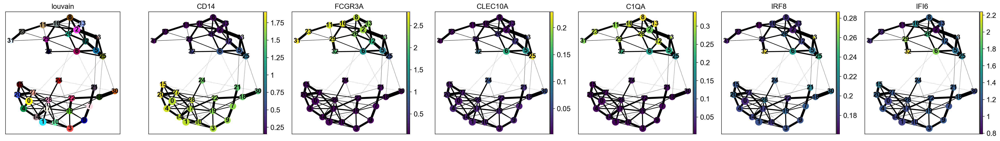

In [49]:
sc.pl.paga(adata_mono, color=['louvain', 'CD14',"FCGR3A","CLEC10A", 'C1QA', 'IRF8', 'IFI6'])

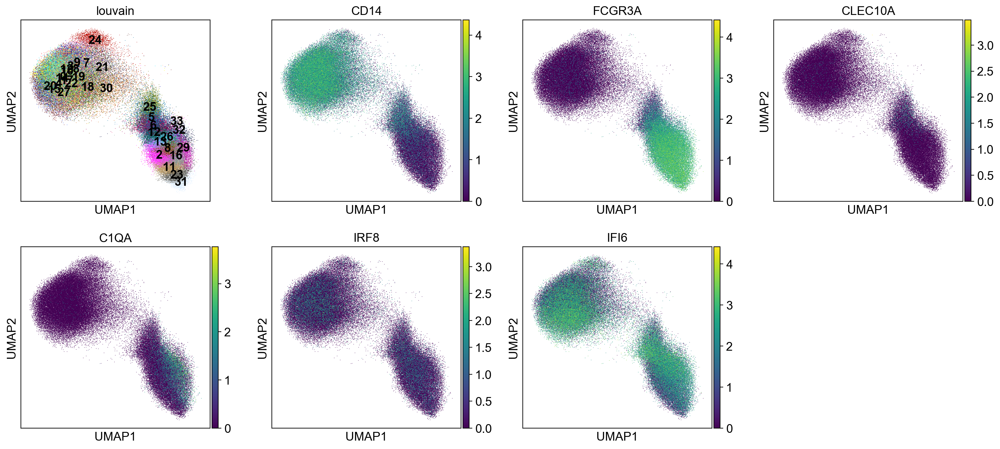

In [50]:
sc.pl.umap(adata_mono, color=['louvain', 'CD14',"FCGR3A","CLEC10A", 'C1QA', 'IRF8', 'IFI6'], legend_loc='on data')

In [51]:
# sc.tl.draw_graph(adata_mono, init_pos='paga')
# sc.pl.draw_graph(adata_mono, color=['louvain', 'CD14',"FCGR3A","CLEC10A", 'C1QA', 'IRF8', 'IFI6'], legend_loc='on data')

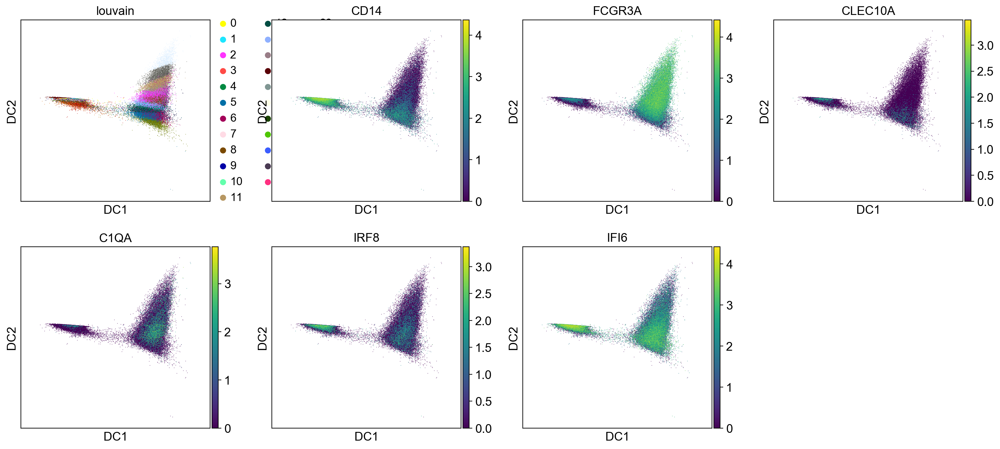

In [52]:
sc.pl.diffmap(adata_mono, color=['louvain', 'CD14',"FCGR3A","CLEC10A", 'C1QA', 'IRF8', 'IFI6'])

In [53]:
adata_mono.uns['iroot'] = np.flatnonzero((adata_mono.obs['louvain']  == '17') | (adata_mono.obs['louvain']  == '14'))[0]
sc.tl.dpt(adata_mono, n_dcs=15)

computing Diffusion Pseudotime using n_dcs=15
    finished (0:00:00)


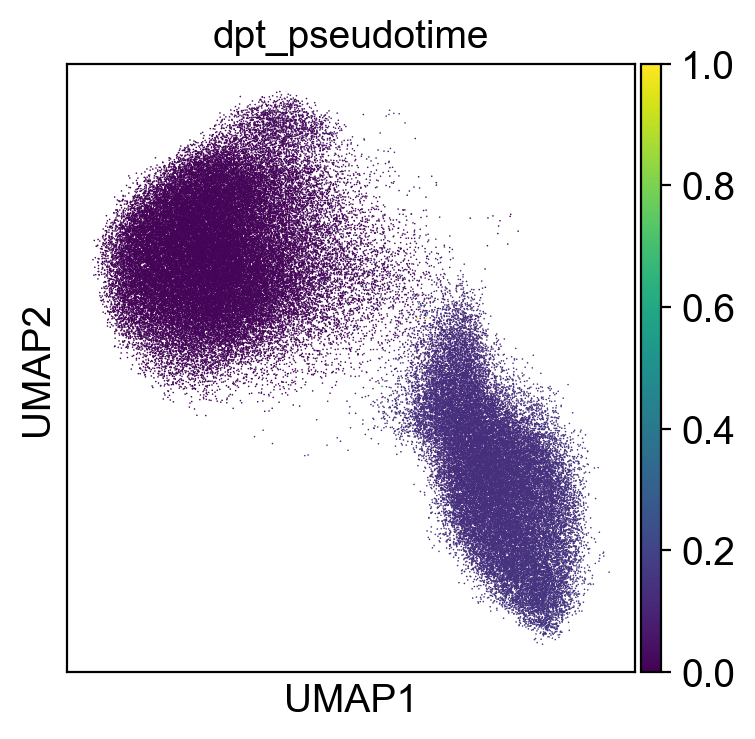

In [54]:
sc.pl.umap(adata_mono, color=['dpt_pseudotime'], legend_loc='on data')

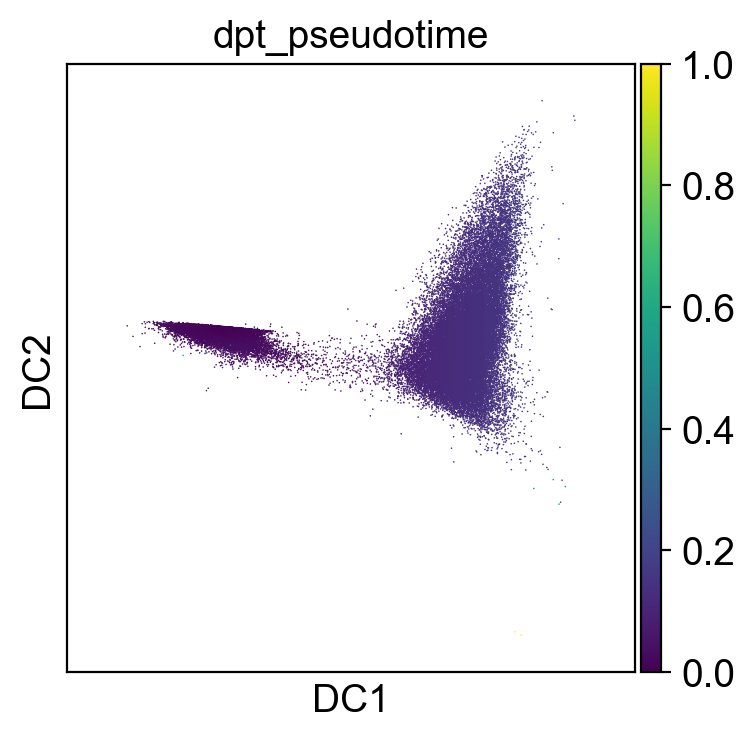

In [55]:
sc.pl.diffmap(adata_mono, color=['dpt_pseudotime'])

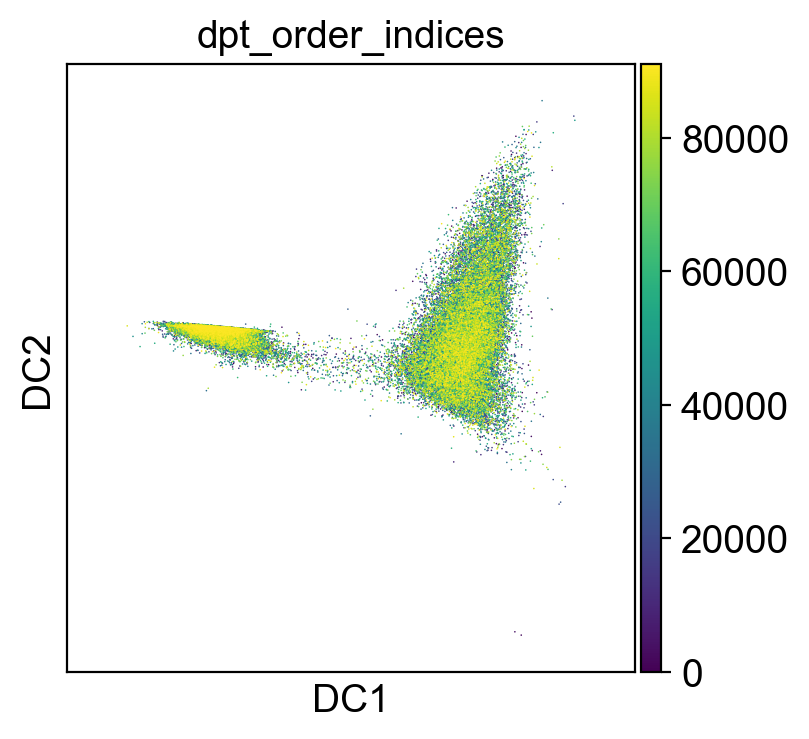

In [56]:
adata_mono.obs['dpt_order_indices'] = adata_mono.obs['dpt_pseudotime'].argsort()
adata_mono.uns['dpt_changepoints'] = np.ones(adata_mono.obs['dpt_order_indices'].shape[0] - 1)
sc.pl.diffmap(adata_mono, color=['dpt_order_indices'])

In [57]:
adata_mono_small = adata_mono[1:100,adata_mono.var_names.isin(["IFI6","MX1"])]

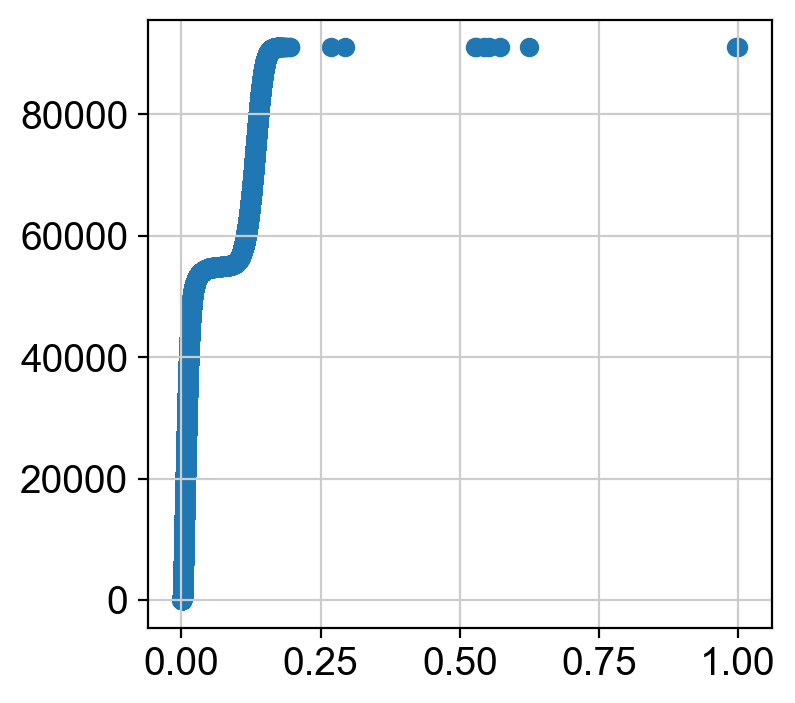

In [58]:
plt.scatter(adata_mono.obs['dpt_pseudotime'], adata_mono.obs['dpt_pseudotime'].rank())

/Users/yimmieg/opt/anaconda3/lib/python3.7/site-packages/anndata/core/anndata.py:299: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


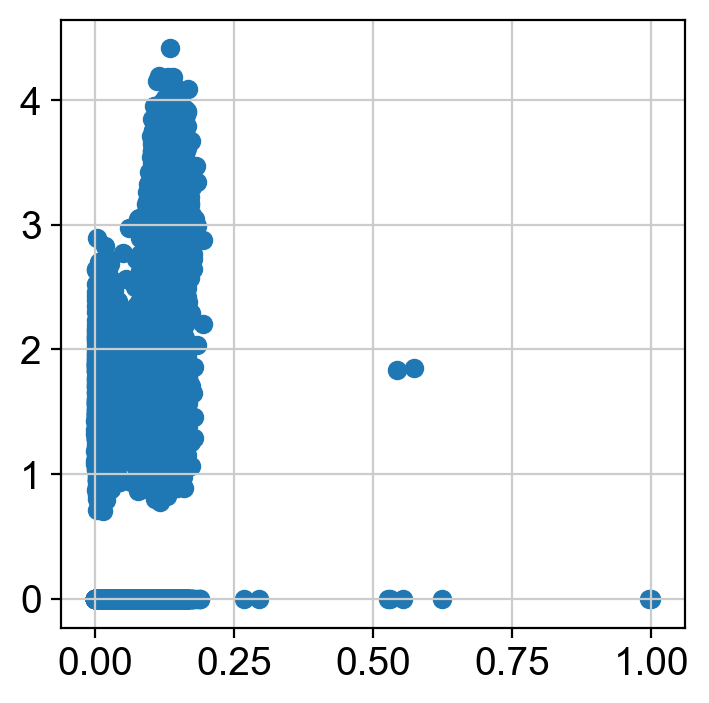

In [59]:
plt.scatter(adata_mono.obs['dpt_pseudotime'], adata_mono.raw[:,"FCGR3A"].X)

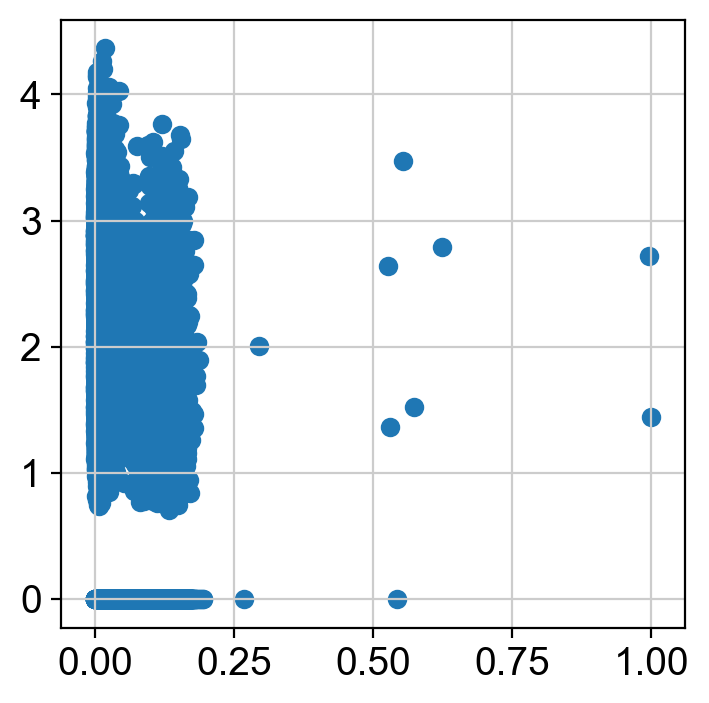

In [60]:
plt.scatter(adata_mono.obs['dpt_pseudotime'], adata_mono.raw[:,"CD14"].X)

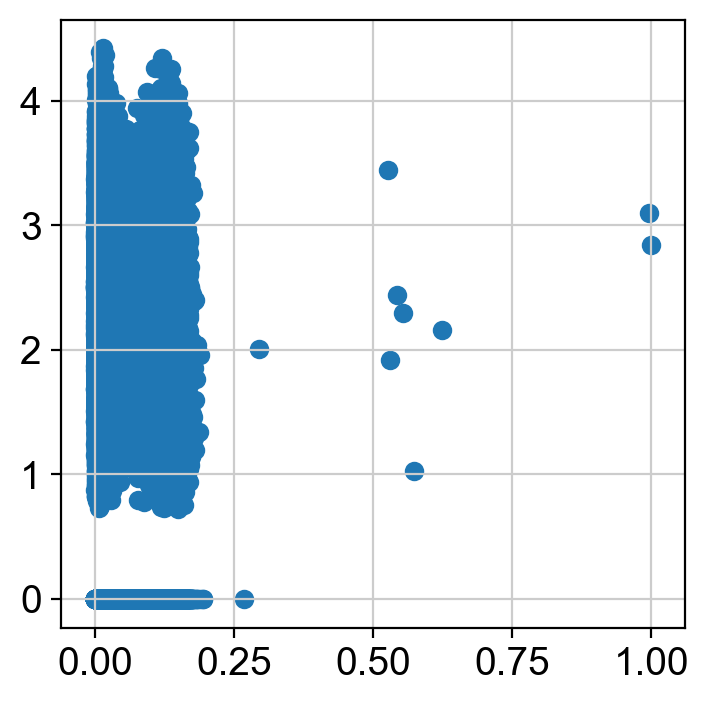

In [61]:
plt.scatter(adata_mono.obs['dpt_pseudotime'], adata_mono.raw[:,"IFI6"].X)

/Users/yimmieg/opt/anaconda3/lib/python3.7/site-packages/anndata/core/anndata.py:846: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


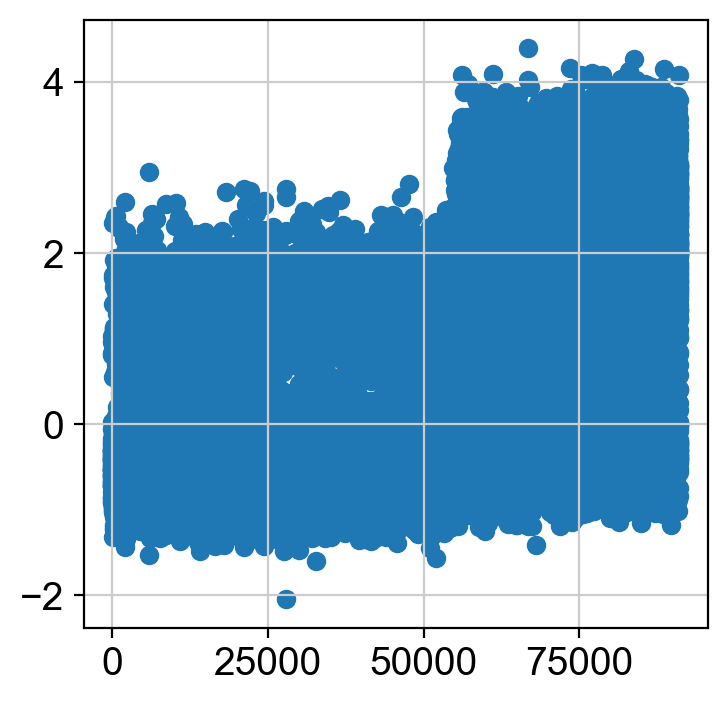

In [62]:
plt.scatter(adata_mono.obs['dpt_pseudotime'].rank(), adata_mono[:,"FCGR3A"].X)

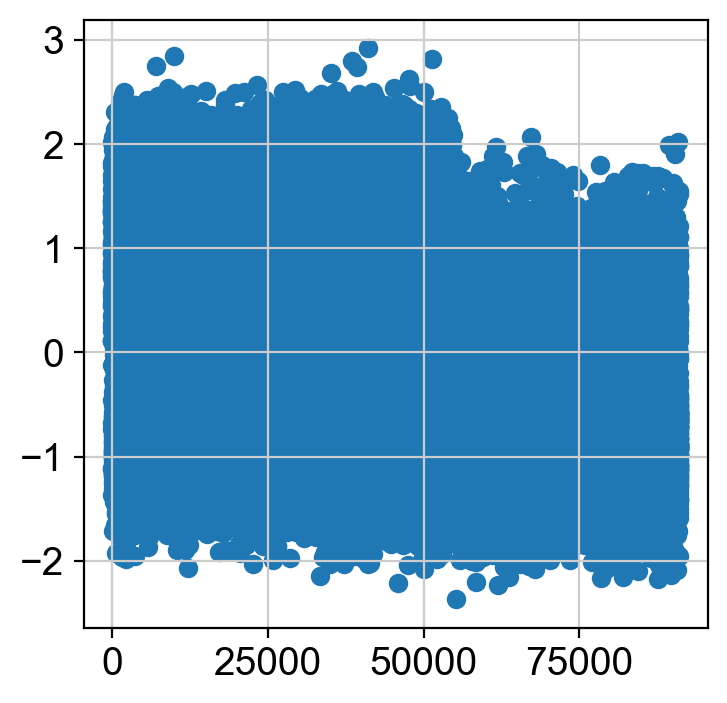

In [63]:
plt.scatter(adata_mono.obs['dpt_pseudotime'].rank(), adata_mono[:,"CD14"].X)

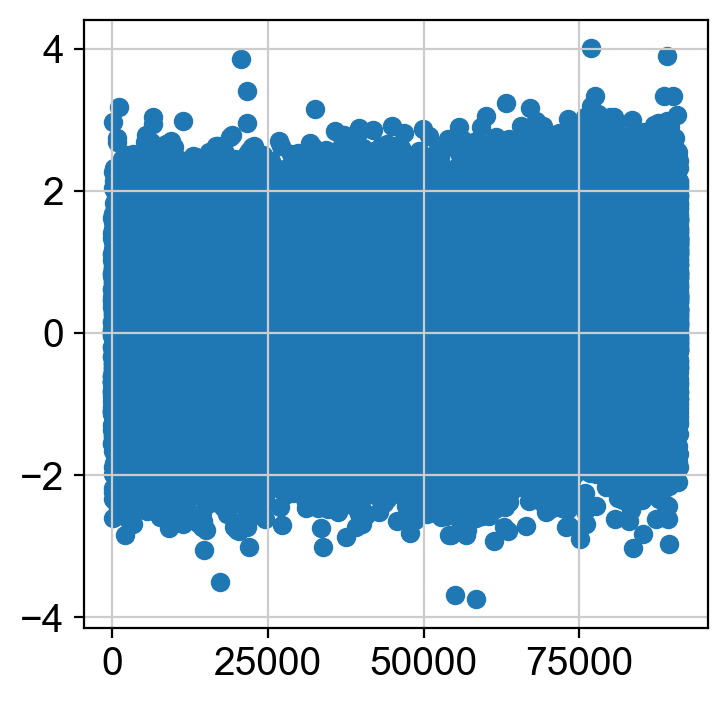

In [64]:
plt.scatter(adata_mono.obs['dpt_pseudotime'].rank(),adata_mono[:,"IFI6"].X)

In [65]:
diffexp_annot.cluster.unique()

[Pan, Mono, ncM, pDC, T4, T8, Lymph, B]
Categories (8, object): [Pan, Mono, ncM, pDC, T4, T8, Lymph, B]

[(0, 0.5)]

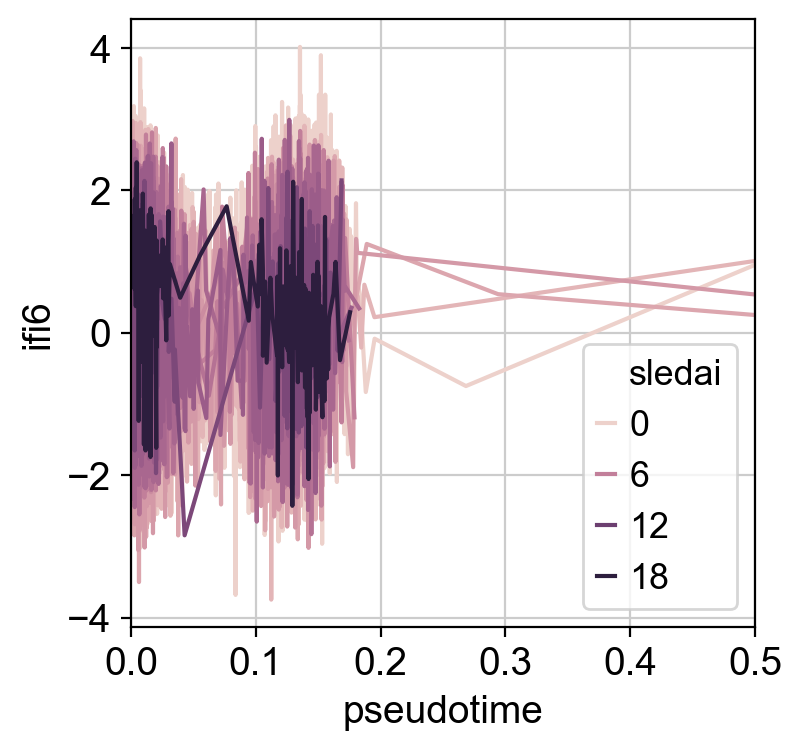

In [66]:
bdata_lineage = pd.DataFrame({"ifi6":np.asarray(adata_mono[:, "IFI6"].X).reshape(-1,), "pseudotime":adata_mono.obs["dpt_pseudotime"], "sledai":adata_mono.obs["SLEDAI"].astype("int64")})
out = sb.lineplot(x="pseudotime", y="ifi6", hue="sledai", data=bdata_lineage)
out.set(xlim=(0,0.5))